In [1]:
import numpy as np
import plotly.graph_objects as go
import ipywidgets as widgets
from IPython.display import display
import glob

### Dos sliders

In [293]:
theta_slider = widgets.IntSlider(value=0, min=0, max=N_Thetas-1, description='Theta')
py_slider = widgets.IntSlider(value=0, min=0, max=N_Py-1, description='Py')
out = widgets.Output()

# Function to update the plot
def update_plot(change=None):
    theta_idx = theta_slider.value
    py_idx = py_slider.value
    x = IPPS_di[0, theta_idx, py_idx]
    y = IPPS_di[1, theta_idx, py_idx]
    z = IPPS_di[2, theta_idx, py_idx]
    
    # Point trace
    point_trace = go.Scatter3d(
        x=[x], y=[y], z=[z],
        mode='markers',
        marker=dict(size=6, color='blue')
    )

    # Tetrahedron edges
    tetra_vertices = np.array([
        [0, 0, 0],
        [1, 1, 1],
        [0, 1, 1],
        [0, 0, 1]
    ])
    edges = [(0,1), (0,2), (0,3), (1,2), (1,3), (2,3)]
    tetra_lines = []
    for i, j in edges:
        tetra_lines.append(go.Scatter3d(
            x=[tetra_vertices[i,0], tetra_vertices[j,0]],
            y=[tetra_vertices[i,1], tetra_vertices[j,1]],
            z=[tetra_vertices[i,2], tetra_vertices[j,2]],
            mode='lines',
            line=dict(color='black', width=2),
            showlegend=False
        ))

    fig = go.Figure(data=[point_trace] + tetra_lines)
    fig.update_layout(
        scene=dict(
            xaxis=dict(range=[0, 1]),
            yaxis=dict(range=[0, 1]),
            zaxis=dict(range=[0, 1])
        ),
        margin=dict(l=0, r=0, t=0, b=0),
        title=f"Theta: {sigmaTheta[theta_idx]:.4f}, PyM: {pyM[py_idx]:.4f}"
    )
    
    with out:
        out.clear_output(wait=True)
        display(fig)

NameError: name 'N_Thetas' is not defined

In [36]:
# Trigger update when sliders move
theta_slider.observe(update_plot, names="value")
py_slider.observe(update_plot, names="value")

# Initial plot
update_plot()

# Display everything
display(theta_slider, py_slider, out)

IntSlider(value=8, description='Theta', max=9)

IntSlider(value=9, description='Py', max=9)

Output(outputs=({'output_type': 'display_data', 'data': {'application/vnd.plotly.v1+json': {'data': [{'marker'…

# Functions

In [159]:
def plot_whole_range(start, end='', middle=[], no=[]):
    fig = go.Figure()

    # Tetrahedron
    tetra_vertices = np.array([
        [0, 0, 0],
        [1, 1, 1],
        [0, 1, 1],
        [0, 0, 1]
    ])
    edges = [(0,1), (0,2), (0,3), (1,2), (1,3), (2,3)]

    lines = []
    for i, j in edges:
        lines.append(go.Scatter3d(
            x=[tetra_vertices[i, 0], tetra_vertices[j, 0]],
            y=[tetra_vertices[i, 1], tetra_vertices[j, 1]],
            z=[tetra_vertices[i, 2], tetra_vertices[j, 2]],
            mode='lines',
            line=dict(color='black', width=2),
            showlegend=False
        ))

    all_scatters=[]

    files1 = glob.glob("Data/"+start+"*"+"*".join(middle)+"*"+end+"*.npy")
    files = [f for f in files1 if not any(n in f for n in no)]
    for filename in files:
        if len(filename)>25:
            data = np.load(filename)
            name = filename.removeprefix("Data\\"+start+"_").removesuffix(".npy")
            
            x_vals = data[0,:,:].flatten()
            y_vals = data[1,:,:].flatten()
            z_vals = data[2,:,:].flatten()
            
            scatter = go.Scatter3d(
                x=x_vals, y=y_vals, z=z_vals,
                mode='markers',
                marker=dict(size=2),
                name= name
            )
            all_scatters.append(scatter)

    
    fig.add_traces(all_scatters + lines)

    camera_state = dict(eye=dict(x=2, y=0.4, z=1.4),center=dict(x=0, y=0, z=-0.2))
    fig.update_layout(
        scene=dict(
            xaxis=dict(range=[0, 1], title='P₁'),
            yaxis=dict(range=[0, 1], title='P₂'),
            zaxis=dict(range=[0, 1], title='P₃'),
            camera=camera_state
            
        ),
        hoverlabel=dict(
            font_size=10,
        ),
        margin=dict(l=0, r=0, b=0, t=30),
        title = start
    )

    fig.show()
    
    

In [161]:
def plot_range(data, name):
    x_vals = data[0,:,:].flatten()
    y_vals = data[1,:,:].flatten()
    z_vals = data[2,:,:].flatten()

    fig = go.Figure()

    scatter = go.Scatter3d(
        x=x_vals, y=y_vals, z=z_vals,
        mode='markers',
        marker=dict(size=2),
        name='Points'
    )

    # Tetrahedron
    tetra_vertices = np.array([
        [0, 0, 0],
        [1, 1, 1],
        [0, 1, 1],
        [0, 0, 1]
    ])
    edges = [(0,1), (0,2), (0,3), (1,2), (1,3), (2,3)]

    lines = []
    for i, j in edges:
        lines.append(go.Scatter3d(
            x=[tetra_vertices[i, 0], tetra_vertices[j, 0]],
            y=[tetra_vertices[i, 1], tetra_vertices[j, 1]],
            z=[tetra_vertices[i, 2], tetra_vertices[j, 2]],
            mode='lines',
            line=dict(color='black', width=2),
            showlegend=False
        ))

    fig.add_traces([scatter] + lines)
    camera_state = dict(eye=dict(x=2, y=0.4, z=1.4),center=dict(x=0, y=0, z=-0.2))
    
    fig.update_layout(
        scene=dict(
            xaxis=dict(range=[0, 1], title='P₁'),
            yaxis=dict(range=[0, 1], title='P₂'),
            zaxis=dict(range=[0, 1], title='P₃'),
            camera=camera_state
        ),
        margin=dict(l=0, r=0, b=0, t=30),
        title=name
    )

    fig.show()
    

In [163]:
def plot_purity(data, name, var1, var1_title, var2, var2_title, slider=1):

    if slider==1:
        slider_var = var1
        slider_title = var1_title
        colored_var = var2
        colored_title = var2_title
        N=len(slider_var)
        slider = widgets.IntSlider(value=0, min=0, max=N-1, description=slider_title)
        data=np.swapaxes(data, 1, 2)
    
    elif slider==2:
        slider_var = var2
        slider_title = var2_title
        colored_var = var1
        colored_title = var1_title
        N=len(slider_var)
        slider = widgets.IntSlider(value=0, min=0, max=N-1, description=slider_title)
      

    # Initial camera state
    camera_state = dict(eye=dict(x=2, y=0.4, z=1.4), center=dict(x=0, y=0, z=-0.2))  # Default view
    
    # Create FigureWidget
    fig = go.FigureWidget()


    
    # Initial plot setup
    def init_figure():
        idx = slider.value
        x_vals = data[0, :, idx]
        y_vals = data[1, :, idx]
        z_vals = data[2, :, idx]
    
        colors = colored_var
    
        scatter = go.Scatter3d(
            x=x_vals, y=y_vals, z=z_vals,
            mode='markers',
            marker=dict(size=2, color=colors, colorscale='Viridis', colorbar=dict(title=colored_title)),
            name=''
        )
    
        # Tetrahedron edges
        tetra_vertices = np.array([
            [0, 0, 0],
            [1, 1, 1],
            [0, 1, 1],
            [0, 0, 1]
        ])
        edges = [(0,1), (0,2), (0,3), (1,2), (1,3), (2,3)]
    
        lines = []
        for i, j in edges:
            lines.append(go.Scatter3d(
                x=[tetra_vertices[i, 0], tetra_vertices[j, 0]],
                y=[tetra_vertices[i, 1], tetra_vertices[j, 1]],
                z=[tetra_vertices[i, 2], tetra_vertices[j, 2]],
                mode='lines',
                line=dict(color='black', width=2),
                showlegend=False
            ))
    
        fig.add_traces([scatter] + lines)
        fig.update_layout(
            scene=dict(
                xaxis=dict(range=[0, 1], title='P₁'),
        yaxis=dict(range=[0, 1], title='P₂'),
        zaxis=dict(range=[0, 1], title='P₃'),
                camera=camera_state
            ),
            margin=dict(l=0, r=0, b=0, t=30),
            title="Points at "+slider_title+ f" = {slider_var[idx]:.4f}"+"           "+ name
        )
    
    # Update function
    def update_figure(change=None):
        global camera_state
        idx = slider.value
    
        # Save current camera before update
        try:
            camera_state = fig.layout.scene.camera
        except:
            pass
    
        x_vals = data[0, :, idx]
        y_vals = data[1, :, idx]
        z_vals = data[2, :, idx]
    
        fig.data[0].x = x_vals
        fig.data[0].y = y_vals
        fig.data[0].z = z_vals
        fig.data[0].marker.color = colored_var
        fig.update_layout(title="Points at " + slider_title + f"= {slider_var[idx]:.4f}"+"           "+ name,
                          scene_camera=camera_state)
    
    # Bind update
    slider.observe(update_figure, names='value')
    
    # Init and display
    init_figure()
    display(slider, fig)

# Diattenuators

### Normalized diattenuators

In [203]:
# Load the data
name="DNorm_p0_px05_pyV_sthV_spy0"
filename="Data/"+name+".npy"
IPPS = np.load(filename)
pyM = np.load("Data/DNorm_PyM.npy")
sigmaTheta = np.load("Data/DNorm_sigmaTheta.npy")
#Plot
plot_purity( IPPS, name,sigmaTheta*180/np.pi, "SigmaTheta", pyM, "PyM", slider=2)

IntSlider(value=0, description='PyM', max=49)

FigureWidget({
    'data': [{'marker': {'color': array([  0.        ,   3.67346939,   7.34693878,  11.02040816,  14.69387755,
                                          18.36734694,  22.04081633,  25.71428571,  29.3877551 ,  33.06122449,
                                          36.73469388,  40.40816327,  44.08163265,  47.75510204,  51.42857143,
                                          55.10204082,  58.7755102 ,  62.44897959,  66.12244898,  69.79591837,
                                          73.46938776,  77.14285714,  80.81632653,  84.48979592,  88.16326531,
                                          91.83673469,  95.51020408,  99.18367347, 102.85714286, 106.53061224,
                                         110.20408163, 113.87755102, 117.55102041, 121.2244898 , 124.89795918,
                                         128.57142857, 132.24489796, 135.91836735, 139.59183673, 143.26530612,
                                         146.93877551, 150.6122449 , 154.28571429, 157.95918367, 

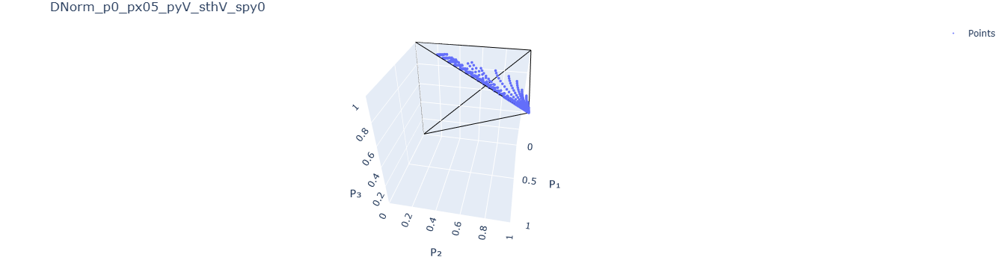

In [185]:
name="DNorm_p0_px05_pyV_sthV_spy0"
filename="Data/"+name+".npy"
IPPS = np.load(filename)
plot_range(IPPS, name)

In [239]:
plot_whole_range('DNorm')

## Not Normalized

In [205]:
# Load the data
name="DNotNorm_p30_px05_pyV_sthV_spy0"
filename="Data/"+name+".npy"
IPPS = np.load(filename)
pyM = np.load("Data/DNorm_PyM.npy")
sigmaTheta = np.load("Data/DNorm_sigmaTheta.npy")
#Plot
plot_purity( IPPS, name,sigmaTheta*180/np.pi, "SigmaTheta", pyM, "PyM", slider=1)

IntSlider(value=0, description='SigmaTheta', max=49)

FigureWidget({
    'data': [{'marker': {'color': array([0.        , 0.02040816, 0.04081633, 0.06122449, 0.08163265, 0.10204082,
                                         0.12244898, 0.14285714, 0.16326531, 0.18367347, 0.20408163, 0.2244898 ,
                                         0.24489796, 0.26530612, 0.28571429, 0.30612245, 0.32653061, 0.34693878,
                                         0.36734694, 0.3877551 , 0.40816327, 0.42857143, 0.44897959, 0.46938776,
                                         0.48979592, 0.51020408, 0.53061224, 0.55102041, 0.57142857, 0.59183673,
                                         0.6122449 , 0.63265306, 0.65306122, 0.67346939, 0.69387755, 0.71428571,
                                         0.73469388, 0.75510204, 0.7755102 , 0.79591837, 0.81632653, 0.83673469,
                                         0.85714286, 0.87755102, 0.89795918, 0.91836735, 0.93877551, 0.95918367,
                                         0.97959184, 1.        ]),
              

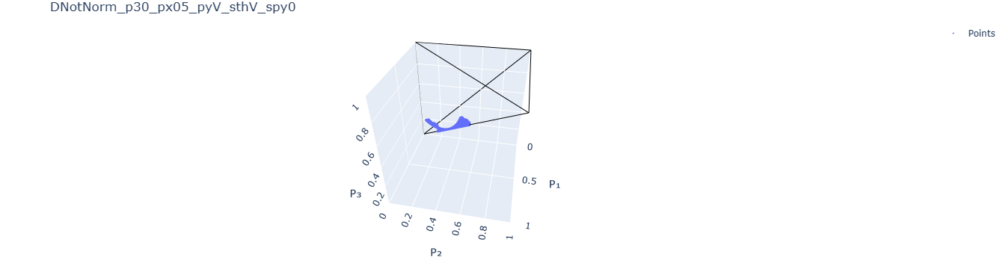

In [207]:
name="DNotNorm_p30_px05_pyV_sthV_spy0"
filename="Data/"+name+".npy"
IPPS = np.load(filename)
plot_range(IPPS, name)

In [241]:
plot_whole_range('DNotNorm', middle=['p80'])

# Retarders

In [223]:
name="R_p0_phiV_sth_V_sphi0"
filename="Data/"+name+".npy"
IPPS = np.load(filename)
phi = np.load("Data/R_PhiM.npy")
sigmaTheta = np.load("Data/R_sigmaTheta.npy")
#Plot
plot_purity(IPPS, name, sigmaTheta*180/np.pi, "SigmaTheta", phi*180/np.pi, "Phi", slider=1)

IntSlider(value=0, description='SigmaTheta', max=49)

FigureWidget({
    'data': [{'marker': {'color': array([  0.        ,   7.34693878,  14.69387755,  22.04081633,  29.3877551 ,
                                          36.73469388,  44.08163265,  51.42857143,  58.7755102 ,  66.12244898,
                                          73.46938776,  80.81632653,  88.16326531,  95.51020408, 102.85714286,
                                         110.20408163, 117.55102041, 124.89795918, 132.24489796, 139.59183673,
                                         146.93877551, 154.28571429, 161.63265306, 168.97959184, 176.32653061,
                                         183.67346939, 191.02040816, 198.36734694, 205.71428571, 213.06122449,
                                         220.40816327, 227.75510204, 235.10204082, 242.44897959, 249.79591837,
                                         257.14285714, 264.48979592, 271.83673469, 279.18367347, 286.53061224,
                                         293.87755102, 301.2244898 , 308.57142857, 315.91836735, 

In [225]:
name="R_p30_phiV_sth_V_sphi0"
filename="Data/"+name+".npy"
IPPS = np.load(filename)
plot_range(IPPS, name)

In [227]:
plot_whole_range("R")

# Diattenuators and retarders

In [217]:
name="Inc_p30_px02_sth90_alpha75_Sinorm"
filename="Data/"+name+".npy"
IPPS = np.load(filename)
phi = np.load("Data/Inc_PhiM.npy")
py = np.load("Data/Inc_PyM.npy")
#Plot
plot_purity( IPPS, name, phi*180/np.pi, "Phi", py, "Py", slider=1)

IntSlider(value=0, description='Phi', max=49)

FigureWidget({
    'data': [{'marker': {'color': array([0.        , 0.02040816, 0.04081633, 0.06122449, 0.08163265, 0.10204082,
                                         0.12244898, 0.14285714, 0.16326531, 0.18367347, 0.20408163, 0.2244898 ,
                                         0.24489796, 0.26530612, 0.28571429, 0.30612245, 0.32653061, 0.34693878,
                                         0.36734694, 0.3877551 , 0.40816327, 0.42857143, 0.44897959, 0.46938776,
                                         0.48979592, 0.51020408, 0.53061224, 0.55102041, 0.57142857, 0.59183673,
                                         0.6122449 , 0.63265306, 0.65306122, 0.67346939, 0.69387755, 0.71428571,
                                         0.73469388, 0.75510204, 0.7755102 , 0.79591837, 0.81632653, 0.83673469,
                                         0.85714286, 0.87755102, 0.89795918, 0.91836735, 0.93877551, 0.95918367,
                                         0.97959184, 1.        ]),
              

In [219]:
name="Inc_p0_px05_sth60_alpha50_Sinorm"
filename="Data/"+name+".npy"
IPPS = np.load(filename)
plot_range(IPPS, name)

In [281]:
plot_whole_range("Inc", middle=['p30', 'px', 'sth20', 'alpha', 'Sinorm'], no=[])

In [279]:
plot_whole_range("Inc", middle=['p', 'px05', 'sth', 'alpha50', 'Sinorm'], no=[])

In [259]:
plot_whole_range("Inc", middle=['p', 'px', 'sth', 'alpha', 'Sinorm'], no=[])